# Customer Lifetime Values
- Reference:
    - [Predicting Customer Lifetime Value (CLV) using Probabilistic Model](https://ishla.medium.com/predicting-customer-lifetime-value-clv-using-probabilistic-model-0330efe4e4b3)

## Introduction
### What is the BG-NBD Model?
- Geometric Beta Distribution / Negative Binomial known as the BG-NBD Model. Also known as "Buy Till You Die," it predicts the *expected number of transactions* in a certain period. This model can answer the following questions:
- How many transactions will occur in the next week?
- How many transactions will occur in the next three months?
- Which customers will make the most purchases in the next two weeks?
### What is the Gamma-Gamma Model?
The Gamma-Gamma model predicts the average profit earned from each customer. After modeling the overall average profit, the *expected average profit* for each customer is obtained.
- A customer's monetary value (the total number of customer transactions) will be randomly distributed around their average transaction value.
- Average transaction value may change over time between customers but does not change for customers.
- The average transaction value will be distributed gamma to all customers as gamma.

In [64]:
#Import Libraries
import pandas as pd  # For data manipulation and analysis
import numpy as np   # For numerical operations on arrays
import matplotlib.pyplot as plt  # For creating plots and graphs
from datetime import timedelta  # For handling time-based calculations

import plotly.graph_objects as go
from plotly.subplots import make_subplots

import datetime as dt # for manipulating dates and times
import lifetimes # Python library for analyzing customer lifetime value

from lifetimes.utils import calibration_and_holdout_data, summary_data_from_transaction_data
from lifetimes.plotting import plot_calibration_purchases_vs_holdout_purchases, plot_period_transactions

from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

from yellowbrick.cluster import KElbowVisualizer

import warnings
warnings.filterwarnings('ignore')

In [13]:
df = pd.read_excel("../../../data/common_datasets/online-retail.xlsx")

In [14]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


## Data Preprocessing

In [15]:
# Dropping rows where 'CustomerID' is missing (NaN)
df = df.dropna(subset=['CustomerID'])

# Converting 'CustomerID' first to integer, then to string.
df['CustomerID'] = df['CustomerID'].astype(int).astype(str)

# Converting 'InvoiceDate' to a datetime object.
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

# Removing rows where 'InvoiceNo' contains the letter 'C', 'C' Stands for cancellation
df = df[~df["InvoiceNo"].str.contains("C", na=False)]

## EDA

In [16]:
# Assuming 'df' is your DataFrame with 'UnitPrice' and 'Quantity' columns
fig = make_subplots(rows=1, cols=2)

# Add a vertical boxplot for 'Quantity' in the first column
fig.add_trace(go.Box(y=df['Quantity'], name='Quantity'), row=1, col=1)

# Add a vertical boxplot for 'UnitPrice' in the second column
fig.add_trace(go.Box(y=df['UnitPrice'], name='UnitPrice'), row=1, col=2)

# Update the layout
fig.update_layout(
    title='Boxplots for Quantity and Unit Price',
    height=400,  # Adjust height as needed
    width=800    # Adjust width as needed
)

# Show the plot
fig.show()

In [17]:
'''
Based on the Boxplot Visualization and statistical summaries,
the data still contains outliers. Therefore, we need to remove these outliers
'''

# Function to remove outliers from a column
def remove_outliers(df, column):
    # Calculate IQR and define bounds for outliers
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    # Remove outliers
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
# Apply the function to each numeric column
for column in df.select_dtypes(include='number').columns:
    df = remove_outliers(df, column)

In [18]:
# Boxplot visualization after remove outliers
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming 'df' is your DataFrame with 'UnitPrice' and 'Quantity' columns
fig = make_subplots(rows=1, cols=2)

# Add a vertical boxplot for 'Quantity' in the first column
fig.add_trace(go.Box(y=df['Quantity'], name='Quantity'), row=1, col=1)

# Add a vertical boxplot for 'UnitPrice' in the second column
fig.add_trace(go.Box(y=df['UnitPrice'], name='UnitPrice'), row=1, col=2)

# Update the layout
fig.update_layout(
    title='Boxplots for Quantity and Unit Price',
    height=400,  # Adjust height as needed
    width=800    # Adjust width as needed
)

# Show the plot
fig.show()

## Train Test Split
- In the dataset, we have 373 days; 
    - 192 days to fit the model
    - 181 to test the model.

In [8]:
#train/test split (calibration/holdout)
#days to reserve for holdout period
t_holdout = 181

# end date of observations
max_date = df["InvoiceDate"].max()
print("End of observations:", max_date)

# end date of chosen calibration period
max_cal_date = max_date - timedelta(days=t_holdout)
print("End of calibration period:", max_cal_date)

End of observations: 2011-12-09 12:50:00
End of calibration period: 2011-06-11 12:50:00


In [20]:
# Calculating the total sum for each transaction
df['TotalSum'] = df['UnitPrice']*df['Quantity']

In [21]:
df_ch = calibration_and_holdout_data(
        transactions = df,
        customer_id_col = "CustomerID",
        datetime_col = "InvoiceDate",
        monetary_value_col = "TotalSum",
        calibration_period_end = max_cal_date,
        observation_period_end = max_date,
        freq = "D"
)

In [23]:
df_ch.tail()

,frequency_cal,recency_cal,T_cal,monetary_value_cal,frequency_holdout,monetary_value_holdout,duration_holdout
CustomerID,,,,,,,
18272,1.0,21.0,65.0,322.0000,4.0,18.891287,181.0
18273,0.0,0.0,76.0,0.0000,1.0,51.000000,181.0
18280,0.0,0.0,96.0,0.0000,0.0,0.000000,181.0
18283,4.0,137.0,156.0,102.0375,9.0,2.941341,181.0
18287,0.0,0.0,20.0,0.0000,2.0,19.277037,181.0


## Training: BG/NBD Model for Number of Purchases

In [25]:
#training: BG/NBD Model
bgf = lifetimes.BetaGeoFitter(penalizer_coef=1e-06)
bgf.fit(
        frequency = df_ch["frequency_cal"],
        recency = df_ch["recency_cal"],
        T = df_ch["T_cal"],
        weights = None,
        verbose = True
)

Optimization terminated successfully.
         Current function value: -0.278287
         Iterations: 53
         Function evaluations: 55
         Gradient evaluations: 55


<lifetimes.BetaGeoFitter: fitted with 2688 subjects, a: 0.00, alpha: 67.16, b: 0.00, r: 0.76>

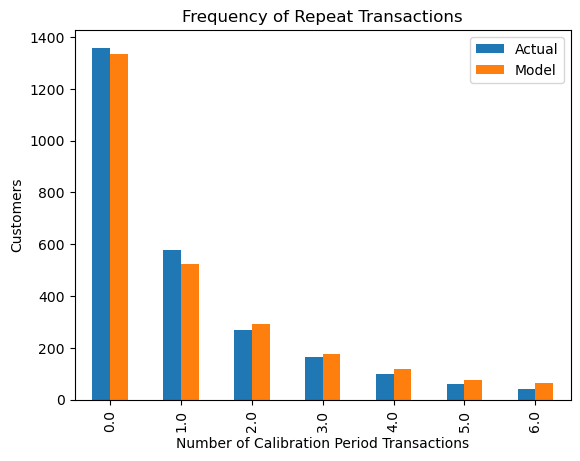

In [37]:
_ = plot_period_transactions(bgf)

<Figure size 700x700 with 0 Axes>

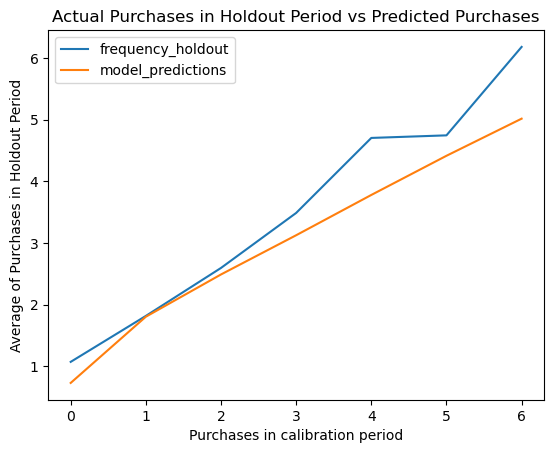

In [36]:
#testing: predicted vs actual purchases in holdout period
fig = plt.figure(figsize=(7, 7))
plot_calibration_purchases_vs_holdout_purchases(bgf, df_ch)
plt.show()

### Model Evaluation

In [33]:
# the real number of transactions in the observation period, which equals frequency_holdout + 1
df_ch["n_transactions_holdout_real"]  = df_ch["frequency_holdout"] + 1

# the predicted number of transactions in the next 181 days (length of the observation period)
df_ch["n_transactions_holdout_pred"] = bgf.predict(t=181,
                                                    frequency=df_ch['frequency_cal'],
                                                    recency=df_ch['recency_cal'],
                                                    T=df_ch['T_cal'])

In [40]:
# Fill NaN values with 0
df_ch["n_transactions_holdout_real"].fillna(0, inplace=True)
df_ch["n_transactions_holdout_pred"].fillna(0, inplace=True)

# Compute RMSE
mean_squared_error(y_true=df_ch["n_transactions_holdout_real"],
                   y_pred=df_ch["n_transactions_holdout_pred"],
                   squared=False)

2.888243784622675

- The model's predictions deviate from the actual purchase frequencies by an average of approximately 2.8 units.

### Predict Future Number of Purchases

In [43]:
#Determine recency, frequency, T, monetary value for each customer
df_rft = lifetimes.utils.summary_data_from_transaction_data(
        transactions = df,
        customer_id_col = "CustomerID",
        datetime_col = "InvoiceDate",
        monetary_value_col = "TotalSum",
        observation_period_end = max_date,
        freq = "D")
df_rft.head()

,frequency,recency,T,monetary_value
CustomerID,,,,
12347,6.0,365.0,367.0,443.973333
12348,2.0,110.0,358.0,18.700000
12349,0.0,0.0,18.0,0.000000
12350,0.0,0.0,310.0,0.000000
12352,6.0,260.0,296.0,150.423333


In [44]:
#BG/NBD Model: refit the model with all the data
bgf = lifetimes.BetaGeoFitter(penalizer_coef=1e-06)
bgf.fit(
        frequency = df_rft["frequency"],
        recency = df_rft["recency"],
        T = df_rft["T"],
        weights = None,
        verbose = True)

Optimization terminated successfully.
         Current function value: -2.398099
         Iterations: 57
         Function evaluations: 58
         Gradient evaluations: 58


<lifetimes.BetaGeoFitter: fitted with 4192 subjects, a: 0.00, alpha: 73.37, b: 0.00, r: 0.84>

In [45]:
bgf.summary

,coef,se(coef),lower 95% bound,upper 95% bound
r,8.413457e-01,2.827173e-02,7.859331e-01,8.967583e-01
alpha,7.336723e+01,2.842817e+00,6.779530e+01,7.893915e+01
a,1.553268e-14,6.322658e-10,-1.239225e-09,1.239257e-09
b,1.917484e-04,7.676922e+00,-1.504658e+01,1.504696e+01


In [46]:
#Function to predict each customer's purchase over next t days
def predict_purch(df, t):
    df["predict_purch_" + str(t)] = \
        bgf.predict(
            t,
            df["frequency"],
            df["recency"],
            df["T"])

#Call function
t_FC = [30, 60, 90, 180]
_ = [predict_purch(df_rft, t) for t in t_FC]
print("predicted number of purchases for each customer over next t days:")
df_rft.head()

predicted number of purchases for each customer over next t days:


,frequency,recency,T,monetary_value,predict_purch_30,predict_purch_60,predict_purch_90,predict_purch_180
CustomerID,,,,,,,,
12347,6.0,365.0,367.0,443.973333,0.466066,0.932133,1.398199,2.796398
12348,2.0,110.0,358.0,18.700000,0.197605,0.395210,0.592815,1.185631
12349,0.0,0.0,18.0,0.000000,0.276252,0.552504,0.828756,NaN
12350,0.0,0.0,310.0,0.000000,0.065839,0.131677,0.197516,0.395032
12352,6.0,260.0,296.0,150.423333,0.555654,1.111308,1.666962,3.333924


In [47]:
#Top 10 customer over next 30 days
print("Top 10 customers, by their predicted purchases over next 30 days")
df_rft.sort_values(by="predict_purch_30", ascending=False).head(10)

Top 10 customers, by their predicted purchases over next 30 days


,frequency,recency,T,monetary_value,predict_purch_30,predict_purch_60,predict_purch_90,predict_purch_180
CustomerID,,,,,,,,
14911,129.0,372.0,373.0,657.349612,8.726538,17.453075,26.179613,52.359226
17841,111.0,372.0,373.0,289.742703,7.516771,15.033543,22.550314,45.100628
12748,110.0,373.0,373.0,191.288000,7.449562,14.899124,22.348686,44.697373
15311,89.0,373.0,373.0,194.881910,6.038168,12.076336,18.114505,36.229009
14606,87.0,372.0,373.0,93.068851,5.903750,11.807499,17.711249,35.422498
12971,63.0,369.0,372.0,84.570317,4.300362,8.600724,12.901087,25.802173
13089,58.0,364.0,368.0,605.829828,3.999482,7.998964,11.998447,23.996893
14527,53.0,367.0,369.0,78.524717,3.651356,7.302713,10.954069,21.908138
14096,16.0,97.0,101.0,2250.573125,2.897565,5.795130,8.692695,17.385390


### Probability of Being Alive
- The probability of being alive is calculated based on the **recency** and **frequency** of a customer.
    - If a customer has bought multiple times (frequency) and the time between the first & last transaction is high (recency), their probability of being alive is high.
    - If a customer has less frequency (bought once or twice) and the time between the first & last transaction is low (recency), their probability of being alive is low.

In [48]:
#Probability that a customer is alive for each customer in dataframe
prob_alive = bgf.conditional_probability_alive(
                frequency = df_rft["frequency"],
                recency = df_rft["recency"],
                T = df_rft["T"])

df_rft["prob_alive"] = prob_alive

In [52]:
df_rft["prob_alive"].describe()

count    4.192000e+03
mean     1.000000e+00
std      1.461732e-10
min      1.000000e+00
25%      1.000000e+00
50%      1.000000e+00
75%      1.000000e+00
max      1.000000e+00
Name: prob_alive, dtype: float64

## Training: Gamma-Gamma Model for Monetary Value of Transactions

In [53]:
# The GG model only works for positive monetary values (>0). 
# Select customers with monetary value > 0
df_rftv = df_rft[df_rft["monetary_value"]>0]

In [55]:
corr_matrix = df_rftv[["monetary_value", "frequency"]].corr()
corr = corr_matrix.iloc[1,0]
corr

0.03581000539285843

- The gamma-gamma Model requires a Pearson correlation close to 0 between purchase frequency and monetary value. 
- The correlation on our dataset seems very weak, at 0.036. 
- Therefore, we can conclude that the assumption is satisfied, and we can fit the model to our data.

In [57]:
# Fine-tuning parameters
penalizer_coef = 1e-06
tolerance = 1e-06

# Fitting the Gamma-Gamma Model
ggf = lifetimes.GammaGammaFitter(penalizer_coef=penalizer_coef)
ggf.fit(
    frequency=df_rftv["frequency"],
    monetary_value=df_rftv["monetary_value"],
    weights=None,  # You may consider using weights if applicable
    verbose=False,
    tol=tolerance,  # Adjust tolerance level for convergence
    q_constraint=True
)

<lifetimes.GammaGammaFitter: fitted with 2656 subjects, p: 2.90, q: 2.65, v: 169.23>

In [59]:
#Estimate the average transaction value of each customer, based on frequency and monetary value
exp_avg_rev = ggf.conditional_expected_average_profit(
                df_rftv["frequency"],
                df_rftv["monetary_value"])
df_rftv["exp_avg_rev"] = exp_avg_rev
mape = mean_absolute_percentage_error(exp_avg_rev, df_rftv["monetary_value"])
mape

0.15735908722555145

-  Mean Absolute Percentage Error (MAPE) between the expected average and actual monetary values, the MAPE of predicted revenues is 15.74%.

## Compute Customer Lifetime Value (CLV)
- Compute the CLV for each customer's next 12 months, assuming the discount rate per year is 6%.

In [60]:
#Compute customer lifetime value
#DISCOUNT_a : annual discount rate
#LIFE : lifetime expected for the customers in months
DISCOUNT_a = 0.06
LIFE = 12

#Monthly discount rate
discount_m = (1 + DISCOUNT_a)**(1/12) - 1

#Expected customer lifetime values
clv = ggf.customer_lifetime_value(
        transaction_prediction_model = bgf,
        frequency = df_rftv["frequency"],
        recency = df_rftv["recency"],
        T = df_rftv["T"],
        monetary_value = df_rftv["monetary_value"],
        time = LIFE,
        freq = "D",
        discount_rate = discount_m)

In [61]:
# Insert the new 'CLV' column
df_rftv.insert(0, "CLV", clv)

In [62]:
# top 10 customer with highest CLV
df_rftv.sort_values(by="CLV", ascending=False).head()

,CLV,frequency,recency,T,monetary_value,predict_purch_30,predict_purch_60,predict_purch_90,predict_purch_180,prob_alive,exp_avg_rev
CustomerID,,,,,,,,,,,
14096,73580.889626,16.0,97.0,101.0,2250.573125,2.897565,5.795130,8.692695,17.385390,1.0,2183.719897
14911,66547.748542,129.0,372.0,373.0,657.349612,8.726538,17.453075,26.179613,52.359226,1.0,655.777466
13089,28038.099316,58.0,364.0,368.0,605.829828,3.999482,7.998964,11.998447,23.996893,1.0,602.850861
17841,25330.512811,111.0,372.0,373.0,289.742703,7.516771,15.033543,22.550314,45.100628,1.0,289.786219
14298,18480.155657,23.0,352.0,360.0,979.278696,1.650426,3.300851,4.951277,9.902554,1.0,962.885739


### CLV Segmentations

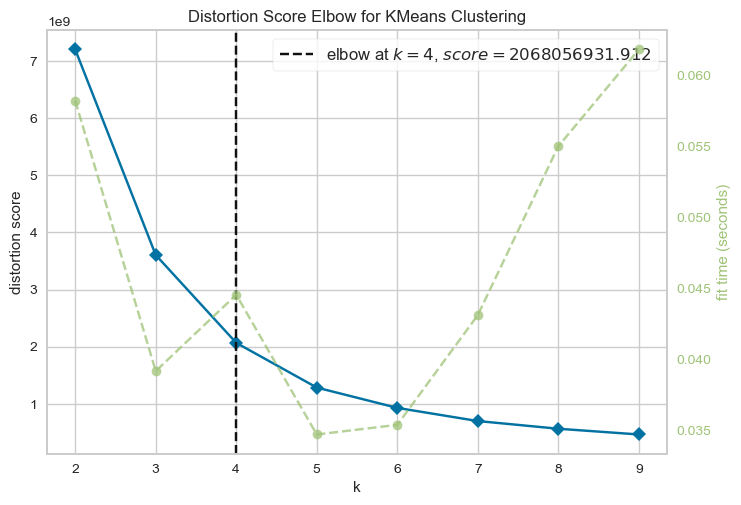

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [65]:
#Instantiate the clustering model and visualizer
km_model = KMeans()
visualizer = KElbowVisualizer(km_model, k=(2,10))

visualizer.fit(df_rftv)
visualizer.show()

In [66]:
# Set random state to 42
random_state = 42

km_model = KMeans(n_clusters=4, random_state=random_state)
km_model.fit(df_rftv)

# Creating new variable called cluster whose are the corresponding cluster for each point
df_rftv['cluster'] = km_model.labels_

In [67]:
#Grouping by clusters
df_clusters = df_rftv.groupby(['cluster'])['CLV']\
                    .agg(['mean', "count"])\
                    .reset_index()

df_clusters.columns = ["clusters", "avg_CLV", "n_customers"]

df_clusters['perct_customers'] = (df_clusters['n_customers']/df_clusters['n_customers']\
                                    .sum())*100

df_clusters

,clusters,avg_CLV,n_customers,perct_customers
0,0,3580.723199,413,15.549699
1,1,937.175788,2222,83.659639
2,2,70064.319084,2,0.075301
3,3,13221.792723,19,0.715361


- Cluster 2 has the highest average CLV, representing (0.075%) with $70.064 &#8594; name the cluster "Platinum" 
- Cluster 3 has the second highest CLV, representing (0.715%) with an average CLV of $13.221 &#8594;  name the cluster "Gold" 
- Cluster 0, representing (15.51%) with an average CLV of $3.583 &#8594; name the cluster "Silver"
- Cluster 1 for the majority (83.70%) of customers with an average CLV of $937 &#8594; name the cluster "Bronze."

In [68]:
#Rename the columns
df_rftv['CLTV_level'] = df_rftv['cluster']\
                            .replace({1:"Bronze", 2:"Platinum", 3:"Gold", 0:"Silver"})